Importing all the required libraries. (As they are pre-installed.)

In [62]:
import pandas as pd #for reading the dataset
import matplotlib.pyplot as plt #for plotting the data
import seaborn as sns #for plotting
import plotly.graph_objs as go 
import plotly.offline as py #for using the different charts offline from the notebook
import plotly.tools as tls
import plotly.express as px
import nltk #library used for Natural Language Processing
from nltk.corpus import stopwords #to get the words that are commonly used
from wordcloud import WordCloud #for creating a wordcloud
import numpy as np #for building the model
from sklearn.feature_extraction.text import CountVectorizer #for conversion of text to a collection of words

Enter the directory with the dataset.

In [2]:
cd archive

/Users/doomsday69/College/ml/sentiment_analysis/archive


# Reading the dataset and performing basic corrections.

In [3]:
df = pd.read_csv('Reviews.csv')

In [4]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


Setting up the color palette and graph parameters.

In [5]:
color = sns.color_palette()

In [6]:
%matplotlib inline

In [7]:
py.init_notebook_mode(connected=True)

Plotting the graph of the product score as a histogram using plotly.express

In [8]:
fig = px.histogram(df, x = 'Score')
fig.update_traces(marker_color='gold', marker_line_color='black', marker_line_width=3.0)
fig.update_layout(title_text='Product Score')
fig.show()

This gives an idea that most customer ratings are positive and well wishing, this implies that the reviews must be positive and uplifting too.

# Creating a wordcloud 
to get access to the most frequently used words in the reviews.

Creating the stopwords list:

There were some errors while using the STOPWORDS set, so I downloaded the stopwords .txt file and used it as a list.

In [9]:
gist_file = open("gist_stopwords.txt", "r")
try:
    content = gist_file.read()
    stopwords = content.split(",")
finally:
    gist_file.close()

Then after updating the stopwords list, joined the text in the review section so as to remove the stopwords and get all the important words for training.

In [10]:
set(stopwords).update(["br", "href"])
textt = " ".join(review for review in df.Text)

Creating a wordcloud by removing the stopwords and collecting all the remaining words.

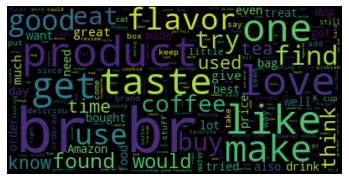

In [19]:
stopwords = nltk.corpus.stopwords.words('english')
wordcloud = WordCloud(stopwords=stopwords).generate(textt)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud11.png')
plt.show()

Now we classify these words as positive and negative for training our model. Positive is +1 and negative is -1. Score>3 is considered positive, while Score<3 is negative. Score=3 is neutral response, therefore we remove the score=3 data.

In [20]:
df=df[df['Score']!=3]

In [21]:
df['Sentiment_score'] = df['Score'].apply(lambda rating : +1 if rating > 3 else -1)

Taking a look at the head of the dataset now:

In [22]:
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Sentiment_score
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1


Creating two dataframes- positive review and negative review for training.

In [42]:
pos = df[df['Sentiment_score'] == 1]
neg = df[df['Sentiment_score'] != 1]

Creating wordclouds for positive and negative words seperately to test later if a word lies in which of them.

In [24]:
set(stopwords).update(["br", "href", "good", "great"]) #good and great removed because they were included in negative sentiment

In [25]:
p = " ".join(review for review in pos.Summary)
wordcloud2 = WordCloud(stopwords=stopwords).generate(p)

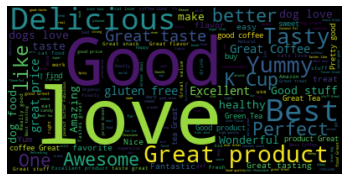

In [49]:
plt.imshow(wordcloud2, interpolation = 'bilinear')
plt.axis("off")
plt.show()

In [50]:
stopwords = nltk.corpus.stopwords.words('english')
#n=" ".join(review for review in neg.Summary)
wordcloud3 = WordCloud(stopwords=stopwords).generate(str(neg.Summary))

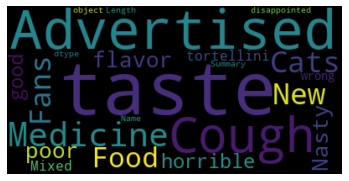

In [51]:
plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud33.png')
plt.show()

We now take a look at the distribution of reviews with sentiment across the dataset:

In [55]:
df['sentimentt'] = df['Sentiment_score'].replace({-1 : 'negative'})
df['sentimentt'] = df['sentimentt'].replace({1 : 'positive'})
fig = px.histogram(df, x="sentimentt")
fig.update_traces(marker_color="indianred",marker_line_color='black',marker_line_width=3)
fig.update_layout(title_text='Product Sentiment')
fig.show()

# Building the model!

This will take reviews in input and return a prediction on whether the review is positive or negative. As this is a classification task, a simple logistic regression model is used. But first, we need to remove all punctuation from the data.

In [56]:
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":",  "!",'"', "/"))
    return final
df['Text'] = df['Text'].apply(remove_punctuation)
df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_punctuation)

Now splitting the dataframe to contain only the summary and the sentiments associated to it.

In [58]:
df2 = df[['Summary','Sentiment_score']]
df2.head()

,Summary,Sentiment_score
0,Good Quality Dog Food,1
1,Not as Advertised,-1
2,Delight says it all,1
3,Cough Medicine,-1
4,Great taffy,1


Now splitting the data frame into training and testing sets. 85% of the data will be used for training, and the remaining 15% will be used for testing. The splitting will be done randomly to test the model better.

In [61]:
index = df.index
df['random_number'] = np.random.randn(len(index))
training = df[df['random_number'] <= 0.85]
testing = df[df['random_number'] > 0.85]

Now using a count vectorizer from the Scikit-learn library, we will transform the text into a collection of words as the logistic regression model cannot take texts as input, and a matrix will be created counting the number of occurence of each word.

In [63]:
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
training_matrix = vectorizer.fit_transform(training['Summary'])
testing_matrix = vectorizer.transform(testing['Summary'])

Importing the logistic regression model from scikit-learn:

In [64]:
from sklearn.linear_model import LogisticRegression

In [65]:
logReg = LogisticRegression()

Splitting the target and the independent variables.

In [69]:
X_train = training_matrix
X_test = testing_matrix
y_train = training['Sentiment_score']
y_test = testing['Sentiment_score']

# Finally, fitting the data to the model and making the predictions:

In [70]:
logReg.fit(X_train,y_train)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/linear_model/_logistic.py:444: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [71]:
predictions = logReg.predict(X_test)

Accuracy of the model.

In [72]:
from sklearn.metrics import confusion_matrix,classification_report
new = np.asarray(y_test)
confusion_matrix(predictions,y_test)

array([[10898,  2174],
       [ 5509, 85304]])

In [73]:
print(classification_report(predictions,y_test))

              precision    recall  f1-score   support

          -1       0.66      0.83      0.74     13072
           1       0.98      0.94      0.96     90813

    accuracy                           0.93    103885
   macro avg       0.82      0.89      0.85    103885
weighted avg       0.94      0.93      0.93    103885



Therefore, the overall accuracy of the model comes out to be around 93%. This can further be increased by using more and more data for training.